#  Analysis of Opening Szechuan Restaurants in Toronto
## The Battle of the Neighbourhoods - Applied Data Science Capstone Project

## Table of contents
* [1. Introduction](#introduction)
* [2. Data Preparation](#data)
* [3. Methodology](#methodology)
* [4. Analysis](#analysis)
* [5. Discussion](#results)
* [6. Conclusion](#conclusion)
* [7. References](#reference)

## 1. Introduction<a name="introduction"></a>

### 1.1 Backgrounds

The Chinese Canadian community in the Greater Toronto Area (GTA) was first established around 1877. According to Statistics Canada - 2016 Census of Population, there are 631,050 Chinese in the Greater Toronto Area, second only to New York City for largest Chinese community in North America. Food and Restaurant is always a vital part in immigrant communities progress, not only maintaining links to homeland culture but also in allowing immigrants to share this culture with the host community. 

### 1.2 Problems

It is well known that there are countless Chinese restaurants located throughout Toronto. However, Szechuan cuisine, which is extrealy welcomed by people all over China, is still a newcomer in Toronto. In this capstone project I will try to identify several areas suitable for new **Szechuan Restaurant** in **Greater Toronto Area**, Ontario.

In the following section I will use knowledges and skills learned from IBM Data Science to locate promising neighbourhoods for Szechuan Restaurant.

### 1.3 Interest

Realtors, financial services companies, immigrants services agencies as well as immigrant investors surging into Canada would be very interested in finding new hotspots for investment.

## 2. Data Preparation<a name="data"></a>

### 2.1 Data Sources

According to the criterion of the analysis, factors that will influence our decision are:
* number of existing Chinese restaurants in the neighborhood
* whether there are Szechuan Restaurant in the neighborhood, and its distance to the existing Szechuan Restaurants

Data sources will be used in this analysis are:
1. List of Postal code of Canada: This [wikipedia page](https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M) is for obtain all the neighborhoods, including postal code, borough in Toronto.
2. Coordinates of Neighborhoods: This [CSV](https://cocl.us/Geospatial_data) file is downloaded from Coursera IBM Data Science course page.
3. Restaurants details, including category and location in Toronto neighborhood will be obtained using __Foursquare API__.
4. Toronto GeoJSON file: City of Toronto Open Data provides [Toronto Boundaries of City of Toronto Neighbourhoods](https://open.toronto.ca/dataset/neighbourhoods/). I used this GeoJson file to create choropleth map for Toronto.
5. Immigration and ethnocultural diversity statistics: [City of Toronto Open Data](https://open.toronto.ca/dataset/neighbourhood-profiles/) and [Census of Population, 2016](https://www12.statcan.gc.ca/census-recensement/2016/ref/index-eng.cfm). These two resources are extremely helpful when conducting this analysis.   
6. City Center of Toronto : Here I am using Toronto City Hall as city center. The geographical coordinates are obtained using __GeoPy__.
7. Business Improvement Areas: A Business Improvement Area (BIA) is an association of commercial property owners and tenants within a defined area who work in partnership with the City to create thriving, competitive, and safe business areas that attract shoppers, diners, tourists, and new businesses. The GeoJson file for BIA could be found [here](https://open.toronto.ca/dataset/business-improvement-areas).

### 2.2 Data Cleaning

In [25]:
# library to handle data in a vectorized manner
import numpy as np 

# library for data analsysis
import pandas as pd 
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# tranform JSON file into a pandas dataframe
from pandas.io.json import json_normalize 

# library to handle requests
import requests 

# library to handle JSON files
import json 

# convert an address into latitude and longitude values
!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim 

# map rendering library
!conda install -c conda-forge folium --yes 
import folium 
from folium import plugins

# Matplotlib and associated plotting modules
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as col

print('Section clear.')

Solving environment: done

# All requested packages already installed.

Solving environment: done

# All requested packages already installed.

Section clear.


#### A. Data: Neighbourhoods List in Toronto (Postal Codes starts with 'M')

In [2]:
# Read wikipedia page
postal_codes = pd.read_html('https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M',header=0)[0]

# Clean dataframe, delete rows with 'Not assigned'
postal_codes = postal_codes[~postal_codes.Borough.str.contains("Not assigned") == True]

# Reset index for dataframe
postal_codes = postal_codes.reset_index(drop=True)
postal_codes.head()

,Postal Code,Borough,Neighborhood
0,M3A,North York,Parkwoods
1,M4A,North York,Victoria Village
2,M5A,Downtown Toronto,"Regent Park, Harbourfront"
3,M6A,North York,"Lawrence Manor, Lawrence Heights"
4,M7A,Downtown Toronto,"Queen's Park, Ontario Provincial Government"


#### B. Data: Geographical Coordinates of Neighbourhoods in Toronto

In [3]:
# Download geospatial data
coor = pd.read_csv('https://cocl.us/Geospatial_data')
coor.head()

,Postal Code,Latitude,Longitude
0,M1B,43.806686,-79.194353
1,M1C,43.784535,-79.160497
2,M1E,43.763573,-79.188711
3,M1G,43.770992,-79.216917
4,M1H,43.773136,-79.239476


#### C. Data : Number of Chinese Restaurants and Szechuan Restaurants in Toronto ( using Foursquare API )

__First let us find out information and details fo Chinese Restaurants__

In [4]:
# Merge two dataframes using left join
dff = pd.merge(postal_codes, coor, how ='left', on =['Postal Code'])
dff = dff.sort_values('Borough').reset_index().drop('index',axis = 1)

First let us define Foursquare Client_ID and Client_Secret. The Foursquare Client_ID and Secret are hidden in cells below.

In [5]:
# The code was removed by Watson Studio for sharing.

Now let us define a function used to extract the category of the venue.

In [6]:
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

Then let us deine a function to obatin restaurants for all the neighbourhoods in Toronto.

In [7]:
# Category IDs corresponding to Szechuan Restaurant were taken from Foursquare web site (https://developer.foursquare.com/docs/resources/categories):
chinese_restaurant = '4bf58dd8d48988d145941735' # Category for Chinese Restaurant
szechuan = '52af3b773cf9994f4e043c03'# Category for szechuan cuisine

In [8]:
def getNearbyVenues(names, latitudes, longitudes, LIMIT = 300, radius = 500, categoryId = chinese_restaurant):
    
    venues_list = []
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT,
            categoryId)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

Well, it is time to create a new dataframe by scratching relevant details of Chinese restaurants using Foursqaure API. 

In [9]:
toronto_cnrestaurant = getNearbyVenues(names = dff['Neighborhood'],
                                   latitudes = dff['Latitude'],
                                   longitudes = dff['Longitude']
                          )

Summerhill West, Rathnelly, South Hill, Forest Hill SE, Deer Park
Davisville
Moore Park, Summerhill East
Forest Hill North & West, Forest Hill Road Park
The Annex, North Midtown, Yorkville
Davisville North
Roselawn
North Toronto West, Lawrence Park
Lawrence Park
Berczy Park
Christie
Central Bay Street
First Canadian Place, Underground city
Toronto Dominion Centre, Design Exchange
Church and Wellesley
University of Toronto, Harbord
Queen's Park, Ontario Provincial Government
Rosedale
Harbourfront East, Union Station, Toronto Islands
Stn A PO Boxes
St. James Town
Richmond, Adelaide, King
Regent Park, Harbourfront
Commerce Court, Victoria Hotel
St. James Town, Cabbagetown
Garden District, Ryerson
CN Tower, King and Spadina, Railway Lands, Harbourfront West, Bathurst Quay, South Niagara, Island airport
Kensington Market, Chinatown, Grange Park
The Beaches
The Danforth West, Riverdale
India Bazaar, The Beaches West
Studio District
Business reply mail Processing Centre, South Central Letter 

In [10]:
# Clean the data a little bit by converting column types. 
toronto_cnrestaurant.iloc[:, [1,2,4,5]].astype(float).values.tolist()

[[43.68641229999999, -79.4000493, 43.685091, -79.397906],
 [43.68641229999999, -79.4000493, 43.68744, -79.394031],
 [43.7043244, -79.3887901, 43.701899125684406, -79.38764921558948],
 [43.6727097, -79.40567840000001, 43.6711958, -79.4056054],
 [43.7153834, -79.40567840000001, 43.71678474928588, -79.40040634837081],
 [43.7280205, -79.3887901, 43.72695269460939, -79.39426004519044],
 [43.644770799999996, -79.3733064, 43.641509989233214, -79.37586057462151],
 [43.644770799999996, -79.3733064, 43.647368, -79.377372],
 [43.644770799999996, -79.3733064, 43.64899366575782, -79.37149443782867],
 [43.6579524, -79.3873826, 43.65643422548463, -79.3837827356398],
 [43.6579524, -79.3873826, 43.655281263429195, -79.3853365267765],
 [43.6579524, -79.3873826, 43.65492521335936, -79.38708916106386],
 [43.6579524, -79.3873826, 43.65503785867478, -79.38589043402241],
 [43.6579524, -79.3873826, 43.65760101432665, -79.38161963017174],
 [43.6579524, -79.3873826, 43.65483285234745, -79.38720597193928],
 [43.

__Then let us obtain Szechuan Restaurants in Toronto__

In [14]:
cnrestaurant_neigh = toronto_cnrestaurant[['Neighborhood', 'Venue']].groupby(['Neighborhood']).size().reset_index(name = 'Number of Chinese Restaurants')
cnrestaurant_neigh.sort_values('Number of Chinese Restaurants',ascending = False, inplace = True)
cnrestaurant_neigh = cnrestaurant_neigh.reset_index().drop('index',axis = 1).set_index('Neighborhood')

In [15]:
# Merge two dataframes using left join
cnf = pd.merge(dff, cnrestaurant_neigh, how = 'right', on = ['Neighborhood'])
cnrestaurant_bor = cnf[['Borough', 'Number of Chinese Restaurants']].groupby(['Borough']).sum().sort_values('Number of Chinese Restaurants',ascending = False)

In [16]:
def getNearbyVenues(names, latitudes, longitudes, LIMIT = 300, radius = 500, categoryId = szechuan):
    
    venues_list = []
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT,
            categoryId)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [89]:
toronto_szechuan = getNearbyVenues(names = cnf['Neighborhood'],
                                   latitudes = cnf['Latitude'],
                                   longitudes = cnf['Longitude']
                          )

Summerhill West, Rathnelly, South Hill, Forest Hill SE, Deer Park
Davisville
The Annex, North Midtown, Yorkville
North Toronto West, Lawrence Park
Lawrence Park
Berczy Park
Central Bay Street
First Canadian Place, Underground city
Toronto Dominion Centre, Design Exchange
Church and Wellesley
University of Toronto, Harbord
Queen's Park, Ontario Provincial Government
Harbourfront East, Union Station, Toronto Islands
Stn A PO Boxes
St. James Town
Richmond, Adelaide, King
Regent Park, Harbourfront
Commerce Court, Victoria Hotel
St. James Town, Cabbagetown
Garden District, Ryerson
Kensington Market, Chinatown, Grange Park
Leaside
Westmount
Alderwood, Long Branch
Downsview
Downsview
Downsview
Downsview
Willowdale, Willowdale East
Don Mills
Don Mills
Bathurst Manor, Wilson Heights, Downsview North
Northwood Park, York University
Bayview Village
Fairview, Henry Farm, Oriole
Steeles West, L'Amoreaux West
Cedarbrae
Clarks Corners, Tam O'Shanter, Sullivan
Kennedy Park, Ionview, East Birchmount Pa

**D. Data : Toronto GeoJSON file**

In [19]:
url = 'https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/a083c865-6d60-4d1d-b6c6-b0c8a85f9c15?format=geojson&projection=4326'
ea_geo = requests.get(url).json()
ea_geo

{'type': 'FeatureCollection',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'_id': 5881,
    'AREA_ID': 25886861,
    'AREA_ATTR_ID': 25926662,
    'PARENT_AREA_ID': 49885,
    'AREA_SHORT_CODE': 94,
    'AREA_LONG_CODE': 94,
    'AREA_NAME': 'Wychwood (94)',
    'AREA_DESC': 'Wychwood (94)',
    'X': None,
    'Y': None,
    'LONGITUDE': -79.425514947,
    'LATITUDE': 43.6769192679,
    'OBJECTID': 16491505,
    'Shape__Area': 3217959.609375,
    'Shape__Length': 7515.779658331329},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-79.4359157087306, 43.6801533947749],
      [-79.4349150633973, 43.6803688699489],
      [-79.4339472722385, 43.6805785044903],
      [-79.433881624222, 43.6805899612147],
      [-79.4328154497888, 43.6808080444588],
      [-79.4326971769691, 43.6807965882232],
      [-79.4325306465987, 43.68082785962871],
      [-79.4324594444965, 43.680858827103606],
      [-

In [65]:
url_ward = 'https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/7672dac5-b383-4d7c-90ec-291dc69d37bf?format=geojson&projection=4326'
ward_geo = requests.get(url_ward).json()
ward_geo

{'type': 'FeatureCollection',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'_id': 1051,
    'AREA_ID': 2457740,
    'DATE_EFFECTIVE': '2018-08-07T18:11:06',
    'DATE_EXPIRY': '3000-01-01T05:00:00',
    'AREA_ATTR_ID': 25993196,
    'AREA_TYPE_ID': 528,
    'PARENT_AREA_ID': None,
    'AREA_TYPE': 'CITW',
    'AREA_CLASS_ID': None,
    'AREA_CLASS': None,
    'AREA_SHORT_CODE': 7,
    'AREA_LONG_CODE': 7,
    'AREA_NAME': 'Humber River-Black Creek',
    'AREA_DESC': 'Humber River-Black Creek (7)',
    'FEATURE_CODE': None,
    'FEATURE_CODE_DESC': None,
    'TRANS_ID_CREATE': 279754,
    'TRANS_ID_EXPIRE': -1,
    'X': None,
    'Y': None,
    'LONGITUDE': -79.5302719567,
    'LATITUDE': 43.7507242813,
    'OBJECTID': 17344785,
    'Shape__Area': 58868732.515625,
    'Shape__Length': 43438.9430476219},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-79.4910534106931, 43.7635021528307],

**E. Data : East and Southeast Asian population of Toronto.**

City of Toronto Neighbourhood Profiles use this Census data to provide a portrait of the demographic, social and economic characteristics of the people and households in each City of Toronto neighbourhood. The profiles present selected highlights from the data, but these accompanying data files provide the full data set assembled for each neighbourhood.

In [21]:
# read data
eastasia_url = 'https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/ef0239b1-832b-4d0b-a1f3-4153e53b189e?format=csv'
eastasia = pd.read_csv(eastasia_url)

# locate rows for East and Southeast Asian population
eastasia = eastasia.iloc[[0,1598]].transpose().reset_index()

# drop irrelevant rows
eastasia = eastasia.iloc[6:]

# reset index and rename columns
eastasia.columns = ['Neighborhood','Neighbourhood Number','Population']
eastaisa = eastasia.set_index('Neighborhood')[['Neighbourhood Number','Population']]

# change data types
eastasia['Population'] = eastasia['Population'].replace(',','', regex = True).astype(float)
eastasia['Neighbourhood Number'] = eastasia['Neighbourhood Number'].astype(float)

eastasia.head()

,Neighborhood,Neighbourhood Number,Population
6,Agincourt North,129.0,18575.0
7,Agincourt South-Malvern West,128.0,13075.0
8,Alderwood,20.0,1295.0
9,Annex,95.0,3945.0
10,Banbury-Don Mills,42.0,6920.0


**F. Data : City center of Toronto**

In [22]:
address = 'Toronto, Ontario'

geolocator = Nominatim(user_agent="toronto_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Toronto are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Toronto are 43.6534817, -79.3839347.


**G. Data: Chinatown area of Toronto**

In [76]:
url_bia = 'https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/d173e644-ace0-45e0-be43-8ba02fb116eb?format=geojson&projection=4326'
bia_geo = requests.get(url_bia).json()
bia_geo

{'type': 'FeatureCollection',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'_id': 3547,
    'AREA_ID': 2481875,
    'DATE_EFFECTIVE': '2020-02-04T17:20:36',
    'AREA_ATTR_ID': 26006975,
    'PARENT_AREA_ID': None,
    'AREA_SHORT_CODE': '115-00',
    'AREA_LONG_CODE': '115-00',
    'AREA_NAME': 'Rogers Road',
    'AREA_DESC': 'Rogers Road',
    'X': 307227.635,
    'Y': 4837983.077,
    'LONGITUDE': -79.46989000149999,
    'LATITUDE': 43.681791364300004,
    'OBJECTID': 17568785,
    'Shape__Area': 351093.85546875,
    'Shape__Length': 5936.86279613381},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[-79.466243629392, 43.6824115082724],
       [-79.4661715206652, 43.6824279773565],
       [-79.4661942618913, 43.6824830991086],
       [-79.4661943114383, 43.6824832161403],
       [-79.4663610320235, 43.6828875591704],
       [-79.4662438439889, 43.6829136194216],
       [-79.4662

## 3. Methodology<a name="methodology"></a>

In this section I will try to find patterns for exisiting Chinese/Szechuan Restaurants in Toronto and spot potential venues for opening new Szechuan Restaurants. Toronto is the most populous city in Canada and the fourth most populous city in North America with 140 neighbourhoods. However, according to [Toronto Neighbourhood Population Profiles](https://www.toronto.ca/wp-content/uploads/2017/12/9386-city-planning-tocore-neighbourhood-population-profiles-aoda-07-04-2016.pdf), the estimated downtown population of Toronto in 2015 is between 242,845 to 245,830, compared to 2,956,024 of [City Toronto](https://www.toronto.ca/city-government/data-research-maps/toronto-at-a-glance/). In that case, there must be some distinct business approaches to open a business in and out of downtown area. Besides, the Immigration and ethnocultural diversity in toronto, which in our project we will focus on East and Southeast Asians population distributions in Toronto, will have impacts on locations and numbers of our target restaurants.In following sections we are expected to see some totally different strategies for local Chinese and Szechuan restaurants.   

Now we have our data:
* __Toronto GeoJSON file__ and __Toronto Neighbourhoods Profiles__ for Choropleth Map based on population density of East and Southeast Asians population
* __Number of Chinese Restaurants and locations in Toronto__
* __Number of Szechuan Restaurants and locations in Toronto__

First I will try to visualize number and locations of Chinese Restaurants in and out of Toronto Downtown area in each neighbourhood.
Then let us try to find patterns for locations of Chinese Restaurants in and out of Toronto Downtown area. I will use __heatmaps__ to conduct this analysis.
Last I will use __Density Based Clustering__ to find patterns of Chinese/Szechuan Restaurants and identify certain cluster groups as candidate neighbourhoods for opening Szechuan Restaurants. 

*Most of the traditional clustering techniques, such as k-means, hierarchical and fuzzy clustering, can be used to group data without supervision. However, when applied to tasks with arbitrary shape clusters, or clusters within cluster, the traditional techniques might be unable to achieve good results. That is, elements in the same cluster might not share enough similarity or the performance may be poor. Additionally, Density-based Clustering locates regions of high density that are separated from one another by regions of low density. Density, in this context, is defined as the number of points within a specified radius. In this section, the main focus will be manipulating the data and properties of DBSCAN and observing the resulting clustering.*

## 4. Analysis<a name="analysis"></a>

### 4.1 Visualize number of Chinese Restaurants in Toronto ( neighbourhoods )

Here we can create a bar chart to better analyze the data.

Text(5.7, 35, 'Most of the Chinese Restaurants are in China Town area')

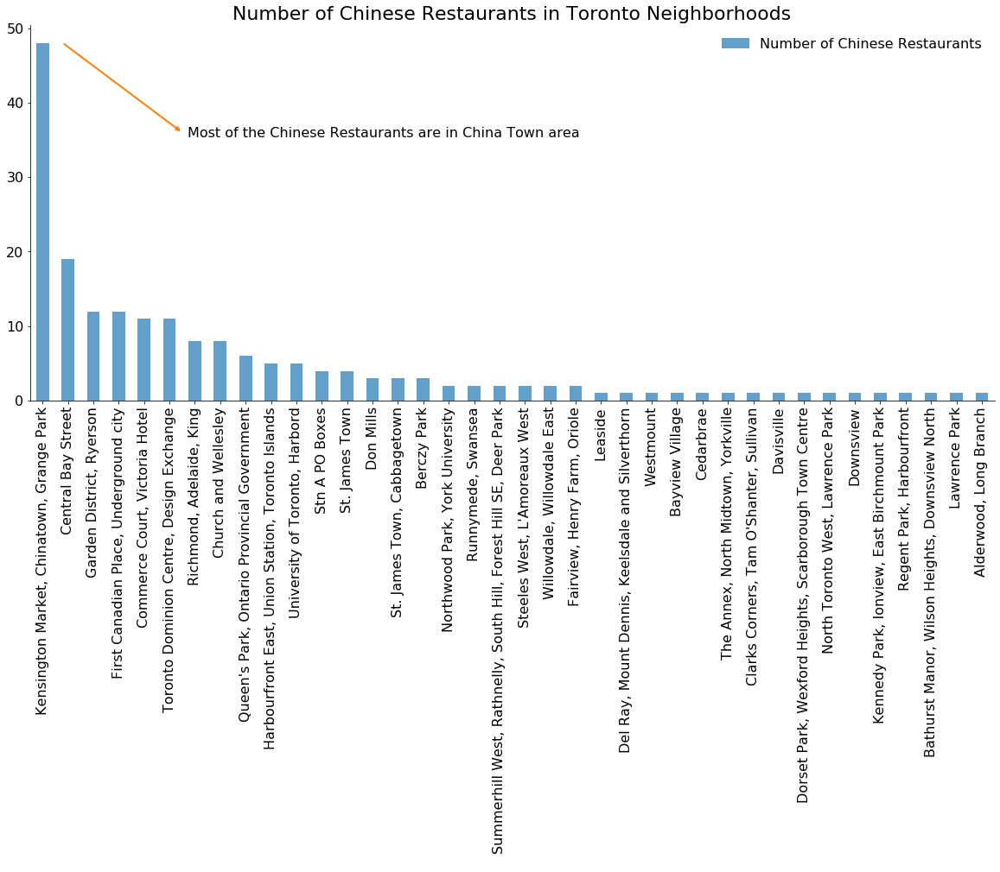

In [30]:
# plot
ax = cnrestaurant_neigh.plot(kind = 'bar', figsize = (20,8), width = 0.5, color='tab:blue',alpha = 0.7,rot = 90)

# set title and legend
ax.set_title("Number of Chinese Restaurants in Toronto Neighborhoods",fontsize = 22)
ax.set_xlabel(' ')
ax.legend(loc='upper right',fontsize=16,facecolor='white',frameon=False) 
ax.tick_params(axis="x", labelsize=16)
ax.tick_params(axis="y", labelsize=16)

# remove borders
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.yaxis.set_visible(True)

# remove background
ax.set_facecolor("White")

# Annotate arrow
plt.annotate('',                      # s: str. will leave it blank for no text
             xy=(0.8, 48),             # place head of the arrow at point
             xytext=(5.5, 36),         # place base of the arrow at point
             xycoords='data',         # will use the coordinate system of the object being annotated 
             arrowprops=dict(arrowstyle='<-', connectionstyle='arc3', color='tab:orange', lw=2)
            )

# Annotate Text
plt.annotate('Most of the Chinese Restaurants are in China Town area', # text to display
             xy=(5.7, 35),                  # start the text at at point 
             va='bottom',                    # want the text to be vertically 'bottom' aligned
             ha='left',                      # want the text to be horizontally 'left' algned
             fontsize=16
            )

We can see from the bar chart that the dominant number of Chinese Restaurants are in Kensington Market, Chinatown and Grange Park, all of them are in downtown area, which totally make sense since it is the commercial and business center of a city. 

### 4.2 Visualize number of Chinese Restaurants in Toronto ( boroughs )

We can also create a bar chart to show number of Chinese Restaurants in different Boroughs.

Text(2.2, 25, 'But why there are so many Chinese Restaurants in North York area?')

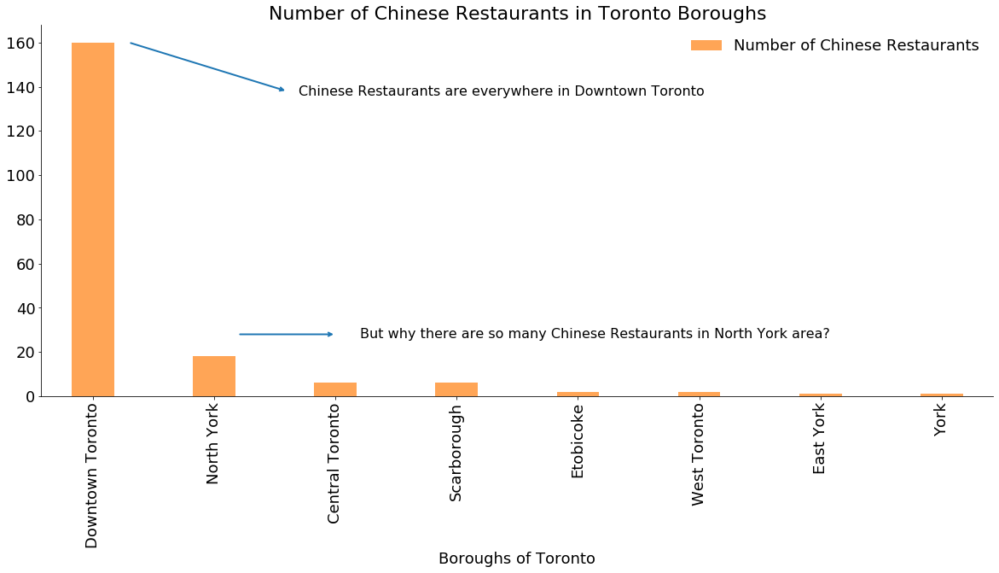

In [40]:
# plot
ax = cnrestaurant_bor.plot(kind='bar', figsize=(20,8), width=0.35, color='tab:orange',alpha=0.7,rot=90)

# set title and legend
ax.set_title("Number of Chinese Restaurants in Toronto Boroughs",fontsize=22)
ax.set_xlabel('Boroughs of Toronto',fontsize=18)
ax.legend(loc='upper right',fontsize=18,facecolor='white',frameon=False) 
ax.tick_params(axis="x", labelsize=18)
ax.tick_params(axis="y", labelsize=18)

# remove borders
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.yaxis.set_visible(True)

# remove background
ax.set_facecolor("White")

# Annotate 2 arrows
plt.annotate('',                      
             xy=(0.3, 160),             # place head of the arrow at point
             xytext=(1.6, 138),         # place base of the arrow at point
             xycoords='data',           # will use the coordinate system of the object being annotated 
             arrowprops=dict(arrowstyle='<-', connectionstyle='arc3', color='tab:blue', lw=2)
            )

plt.annotate('',                     
             xy=(1.2, 28),              # place head of the arrow at point
             xytext=(2.0, 28),          # place base of the arrow at point
             xycoords='data',           # will use the coordinate system of the object being annotated 
             arrowprops=dict(arrowstyle='<-', connectionstyle='arc3', color='tab:blue', lw=2)
            )

# Annotate Text
plt.annotate('Chinese Restaurants are everywhere in Downtown Toronto', # text to display
             xy=(1.7, 135),             # start the text at at point 
             va='bottom',               # want the text to be vertically 'bottom' aligned
             ha='left',                 # want the text to be horizontally 'left' algned
             fontsize=16
            )

plt.annotate('But why there are so many Chinese Restaurants in North York area?', # text to display
             xy=(2.2, 25),              # start the text at at point 
             va='bottom',               # want the text to be vertically 'bottom' aligned
             ha='left',                 # want the text to be horizontally 'left' algned
             fontsize=16
            )

In [41]:
cnrestaurant_bor.reset_index(inplace=True)

In [42]:
cnrestaurant_bor

,Borough,Number of Chinese Restaurants
0,Downtown Toronto,160
1,North York,18
2,Central Toronto,6
3,Scarborough,6
4,Etobicoke,2
5,West Toronto,2
6,East York,1
7,York,1


However, when we turn to borough analysis, there is a different story. The high density of Chinese restaurants in downtown is totally making sense. Then why the number of chinese Restaurants in North York area stands out?

### 4.3 Create a choropleth map of Toronto

In order to find reasons for high number of Chinese Restaurants in North York, let us try to create choropleth map of Toronto and see whether there is __positive correlation__ between high population density of East and Southeast Asians and numbers of Chinese Restaurants.

In [231]:
# Create choropleth map.
c = folium.Map(location=[latitude,longitude], tiles='cartodbpositron', zoom_start=11)

# Add choropleth to the map, set as 
c.choropleth(
    geo_data=ea_geo,
    data = eastasia,
    columns=['Neighbourhood Number','Population'],
    key_on='feature.properties.AREA_SHORT_CODE',
    line_weight = 0.2,
    fill_color='YlOrBr',
    fill_opacity= 0.3,
    line_opacity= 0.2, 
    legend_name='Population of East and Southeast Asian origins',
    name = 'Choropleth Map of Neighborhoods 140')

ward_style = lambda x: {'fillColor': '#aeaeae', 'color': '#aeaeae','fillOpacity':'0.1'}
folium.GeoJson(
    ward_geo,
    style_function = ward_style,
    name='Neighborhoods 44 Model'
).add_to(c)

# add the Chinese Restaurants as brown circle markers:
for index,row in toronto_cnrestaurant.iterrows():
    folium.CircleMarker(
        [row["Venue Latitude"], row["Venue Longitude"]],
        radius=2,
        color='#8b4513',
        fill= True,
        fill_color='#8b4513',
        fill_opacity= 0.1,
        popup='Chinese Restaurant',
    ).add_to(c)
c

According to [Toronto Open Data](https://www.toronto.ca/wp-content/uploads/2019/01/9710-City_Planning_2016_Census_Profile_2018_CCA_NorthYork.pdf), the North York neighbourhoods are consisted of ward 6, 8, 15, 16, 17, 18, with high density of East and Southeast Asians origins. From the map above we can conclude that there is __positive correlation__ between high population density of East and Southeast Asians and numbers of Chinese Restaurants. That is our first conclusion.

### 4.4 Map of  Szechuan Restaurants

Now we have data of Chinese Restaurants as well as Szechuan Restaurants. Let us create a map to see their distributions.

In [173]:
# add the Szechuan Restaurants as orange markers:
for index,row in toronto_szechuan.iterrows():
    folium.features.Marker(
        [row["Venue Latitude"], row["Venue Longitude"]],
        popup='Szechuan Restaurant',
        icon=folium.Icon(
            color='orange', 
            icon='glass')
    ).add_to(c)
c

It seems like most of the Szechuan Restaurants tend to stay in clusters with Chinese Restaurants in downtown areas. None of Szechuan Restaurants are spotted in other neighbourhoods besides downtown Toronto. Let us see if we can create a Heatmap to better visualize it.

### 4.5  Create Heatmap for Chinese & Szechuan Restaurants.

In [174]:
# convert to (n, 2) nd-array format for heatmap
torontoArr = toronto_cnrestaurant[['Venue Latitude', 'Venue Longitude']].values
torontoArr = torontoArr.tolist()

# plot heatmap
folium.plugins.HeatMap(torontoArr, radius=15).add_to(c)
c

### 4.6  Create a map for Toronto Business Improvement Area

This heatmap shows that most of Szechuan Restaurants are in Kensington Market, Chinatown. Let us create a BIA (Business Improvement Area) map to see whether it can back up our conclusion.

*Disclaimer : A Business Improvement Area (BIA) is an association of commercial property owners and tenants within a defined area who work in partnership with the City to create thriving, competitive, and safe business areas that attract shoppers, diners, tourists, and new businesses. The BIA layer represents the active BIAs in the City of Toronto that has been enacted by Council. Each BIA has been defined by a by-law and is represented by a Board of Management. The layer is updated as BIAs are created, amended or deleted by Council.*

In [232]:
# Create map for Toronto Business Improvement Area
# I use coordinates of Chinatown to render the map
f = folium.Map(location=['43.6529109','-79.3979871'], tiles='cartodbpositron', zoom_start=16)

ward_style = lambda x: {'fillColor': '#aeaeae', 'color': '#aeaeae','fillOpacity':'0.1'}
folium.GeoJson(
    ward_geo,
    style_function = ward_style,
    name='Neighborhoods 44 Model'
).add_to(f)

# add the Chinese Restaurants as brown circle markers:
for index,row in toronto_cnrestaurant.iterrows():
    folium.CircleMarker(
        [row["Venue Latitude"], row["Venue Longitude"]],
        radius=2,
        color='#8b4513',
        fill= True,
        fill_color='#8b4513',
        fill_opacity= 0.1,
        popup='Chinese Restaurant',
    ).add_to(f)
f

# add the Szechuan Restaurants as orange markers:
for index,row in toronto_szechuan.iterrows():
    folium.features.Marker(
        [row["Venue Latitude"], row["Venue Longitude"]],
        popup='Szechuan Restaurant',
        icon=folium.Icon(
            color='orange', 
            icon='glass')
    ).add_to(f)
f

bia_style = lambda x: {'fillColor': '#aeaeae', 'color': '#aeaeae','fillOpacity':'0.2'}
folium.GeoJson(
    bia_geo,
    style_function = bia_style,
    name='Business Improvement Areas'
).add_to(f)
f

Now we can make several conclusions based on the maps above:
1. Most of the szechuan restaurants (6 out of 12) are in Chinatown. In this area, szechuan restaurants tend to be in clusters with each other.
2. For szechuan restaurants outside of Chinatown, most of them are in neighbourhoods with no Szechuan restaurants nearby. However, they are still in Chinese restaurants clusters.
3. There are several candidates locations for Szechuan restaurants, with no szechuan restaurants nearby and are all in chinese restaurants clusters.

### 4.7 Find optimal locations for New Szechuan Restaurants using DBSCAN

Now let's continue searching for optimal locations for Szechuan restaurants. In this section I will use Density Based Clustering to locate canditate clusters for opening Szechuan Restaurants.

In [219]:
# import DBSCAN from clustering stage 
from sklearn.cluster import DBSCAN
import sklearn.utils
from sklearn.preprocessing import StandardScaler
sklearn.utils.check_random_state(1000)

# let us clean the coordinates data 
xs,ys = np.asarray(toronto_cnrestaurant['Venue Latitude']), np.asarray(toronto_cnrestaurant['Venue Longitude'])
toronto_cnrestaurant['xm'] = xs.tolist()
toronto_cnrestaurant['ym'] = ys.tolist()

# use DBSCAN to label clusters
Clus_dataSet = toronto_cnrestaurant[['xm','ym']]
Clus_dataSet = np.nan_to_num(Clus_dataSet)
Clus_dataSet = StandardScaler().fit_transform(Clus_dataSet)

db =DBSCAN(eps=0.09, min_samples=2).fit(Clus_dataSet)
core_samples_mask = np.zeros_like(db.labels_, dtype = bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# add a column to dataframe 
toronto_cnrestaurant["Clus_Db"] = labels
realClusterNum = len(set(labels)) - (1 if -1 in labels else 0)
clusterNum = len(set(labels)) 

# find kclusters
toronto_cnrestaurant['Clus_Db'] = toronto_cnrestaurant['Clus_Db'].astype(int).tolist()
kclusters = toronto_cnrestaurant['Clus_Db'].max() + 1

# let's see the data
toronto_cnrestaurant

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,xm,ym,Clus_Db
0,"Summerhill West, Rathnelly, South Hill, Forest...",43.686412,-79.400049,SuperBuffet,43.685091,-79.397906,Chinese Restaurant,43.685091,-79.397906,-1
1,"Summerhill West, Rathnelly, South Hill, Forest...",43.686412,-79.400049,Mean Bao,43.687440,-79.394031,Chinese Restaurant,43.687440,-79.394031,-1
2,Davisville,43.704324,-79.388790,South China Restaurant,43.701899,-79.387649,Chinese Restaurant,43.701899,-79.387649,-1
3,"The Annex, North Midtown, Yorkville",43.672710,-79.405678,Dimsum Break,43.671196,-79.405605,Chinese Restaurant,43.671196,-79.405605,-1
4,"North Toronto West, Lawrence Park",43.715383,-79.405678,C'est Bon,43.716785,-79.400406,Chinese Restaurant,43.716785,-79.400406,-1
5,Lawrence Park,43.728020,-79.388790,Dim Sum Deluxe,43.726953,-79.394260,Dim Sum Restaurant,43.726953,-79.394260,-1
6,Berczy Park,43.644771,-79.373306,Water Front,43.641510,-79.375861,Chinese Restaurant,43.641510,-79.375861,0
7,Berczy Park,43.644771,-79.373306,Manchu Wok,43.647368,-79.377372,Chinese Restaurant,43.647368,-79.377372,1
8,Berczy Park,43.644771,-79.373306,Ying Ying Soy Food,43.648994,-79.371494,Chinese Restaurant,43.648994,-79.371494,2
9,Central Bay Street,43.657952,-79.387383,GB Hand-Pulled Noodles,43.656434,-79.383783,Chinese Restaurant,43.656434,-79.383783,3


Now we have clusters labels for each Chinese/Szechuan restaurants. Let's visualize it.

In [233]:
# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.tab20c(np.linspace(0, 1, len(ys)))
rainbow = [col.rgb2hex(i) for i in colors_array]

f.choropleth(
    geo_data=ea_geo,
    data = eastasia,
    columns=['Neighbourhood Number','Population'],
    key_on='feature.properties.AREA_SHORT_CODE',
    line_weight = 0.2,
    fill_color='YlOrBr',
    fill_opacity= 0.3,
    line_opacity= 0.2, 
    legend_name='Population of East and Southeast Asian origins',
    name = 'Choropleth Map of Neighborhoods 140')

# add markers to the map
for lat, lon, neigh, cluster in zip(toronto_cnrestaurant['Venue Latitude'], toronto_cnrestaurant['Venue Longitude'], toronto_cnrestaurant['Neighborhood'], toronto_cnrestaurant['Clus_Db']):
    label = folium.Popup(str(neigh) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-0],
        fill=True,
        fill_color=rainbow[cluster-0],
        fill_opacity=0.7).add_to(f)
f

## 5. Discussion <a name="results"></a>

Now we have our candidate clusters for opening new Szechuan Restaurants. In order to find the optimal clusters, here I set criterion for this analysis:
* the restaurant should be in geographic clustering by Chinese restaurant segment;
* the restaurant should be in a neighbourhood with no Szechuan restaurants nearby;
* the restaurant should be located in a BIA area;
* the restaurant should be located in neighbourhoods with high East and Southeast Asian population density;

Let us take a look at clusters, from outlier cluster label 0 to label 12. Outlier with label -1 will not be included in the analysis.

* **Cluster 0: Potential**.\
1) In Chinese Restaurants Clusters;\
2) No Szechuan Restaurant in Cluster;\
3) In Downtown BIA area;\
4) High population density of East and Southeast Asian origins.\


* **Cluster 1: Potential**.\
1) In Chinese Restaurants Clusters;\
2) Szechuan Restaurant in Cluster;\
3) In Downtown BIA area;\
4) High population density of East and Southeast Asian origins.


* **Cluster 2: Not Recommended**.\
1) Out of Chinese Restaurants Clusters (potential outlier);\
2) No Szechuan Restaurant in Cluster;\
3) In Downtown BIA area;\
4) High population density of East and Southeast Asian origins.


* **Cluster 3: Not Recommended**.\
1) In Chinese Restaurants Clusters;\
2) **FOUR** Szechuan Restaurant in Cluster;\
3) In Downtown BIA area;\
4) High population density of East and Southeast Asian origins.


* **Cluster 4: Fair**.\
1) In Chinese Restaurants Clusters;\
2) No Szechuan Restaurant in Cluster;\
3) Out of Downtown BIA area;\
4) Moderate population density of East and Southeast Asian origins (Near Chinatown).


* **Cluster 5: Potential**.\
1) In Chinese Restaurants Clusters;\
2) No Szechuan Restaurant in Cluster;\
3) In Downtown BIA area;\
4) Low population density of East and Southeast Asian origins (Near Chinatown).


* **Cluster 6: Potential**.\
1) In Chinese Restaurants Clusters;\
2) No Szechuan Restaurant in Cluster;\
3) In Downtown BIA area;\
4) Low population density of East and Southeast Asian origins (Near Chinatown).


* **Cluster 7: Not Recommended**.\
1) In Chinese Restaurants Clusters;\
2) **SIX** Szechuan Restaurant in Cluster;\
3) In Downtown BIA area;\
4) High population density of East and Southeast Asian origins (Chinatown).


* **Cluster 8: Fair**.\
1) In Chinese Restaurants Clusters;\
2) No Szechuan Restaurant in Cluster;\
3) Not in Downtown BIA area;\
4) Moderate population density of East and Southeast Asian origins.


* **Cluster 9: Fair**.\
1) In Chinese Restaurants Clusters;\
2) No Szechuan Restaurant in Cluster;\
3) Not in Downtown BIA area;\
4) Moderate population density of East and Southeast Asian origins.


* **Cluster 10: Fair**.\
1) In Chinese Restaurants Clusters;\
2) No Szechuan Restaurant in Cluster;\
3) Not in Downtown BIA area;\
4) High population density of East and Southeast Asian origins.


* **Cluster 11: Fair**.\
1) In Chinese Restaurants Clusters;\
2) No Szechuan Restaurant in Cluster;\
3) Not in Downtown BIA area;\
4) High population density of East and Southeast Asian origins.


* **Cluster 12: Fair**.\
1) In Chinese Restaurants Clusters;\
2) No Szechuan Restaurant in Cluster;\
3) In Downtown BIA area;\
4) Low population density of East and Southeast Asian origins.

## 6. Conclusion <a name="conclusion"></a>

Finally we have spotted 4 clusters with high potential to open new business. We give it star label with color blue.

In [238]:
tooltip = '<b>potential cluster </b>'
folium.Marker([43.661528, -79.397436], icon=folium.Icon(color='blue', icon='star'), tooltip=tooltip).add_to(f)
folium.Marker([43.641610, -79.375661], icon=folium.Icon(color='blue', icon='star'), tooltip=tooltip).add_to(f)
folium.Marker([43.647368, -79.377372], icon=folium.Icon(color='blue', icon='star'), tooltip=tooltip).add_to(f)
folium.Marker([43.664331, -79.368365], icon=folium.Icon(color='blue', icon='star'), tooltip=tooltip).add_to(f)
f

This concludes our analysis. We have spot **4 cluster Areas** with high potential to open szechuan restaurants, with Chinese Restaurants nearby, no Szechuan Restaurant in cluster, high population density of East and Southeast Asian origins and all clusters in Downtown Toronto Business Improvement Area. 

Please notice this analysis is only a starting line to find and define business patterns of Restaurant & Food service industry. Except for locations, there are still tons of factors that should be taken into considerations such as anticipated sales volume, accessibility to potential customers, rents, security issues et cetera.

## 7. Reference <a name="references"></a>

[1] Vieregge, M., Lin, J. J., Drakopoulos, R., & Bruggmann, C. (2009). Immigrants Perception of Ethnic Restaurants: The Case of Asian Immigrants Perception of Chinese Restaurants in Switzerland. Tourism Culture & Communication, 9(1), 49–64. doi: 10.3727/109830409787556684 \
[2] [Finding Optimal Locations of New Stores by IBM](http://ibmdecisionoptimization.github.io/docplex-doc/mp/chicago_coffee_shops.html) \
[3] [Generating GeoJSON File for Toronto FSAs by Amy Gordon](https://medium.com/dataexplorations/generating-geojson-file-for-toronto-fsas-9b478a059f04) \
[4] [Housing Sales Prices & Venues Data Analysis of Istanbul by Sercan Yıldız](https://www.linkedin.com/pulse/housing-sales-prices-venues-data-analysis-ofistanbul-sercan-y%C4%B1ld%C4%B1z/) \
[5] [Visualizing Geospatial Data in Python Using Folium by Aly Sivji](https://alysivji.github.io/getting-started-with-folium.html)
[6] [Folium Documentation 0.11.0](https://python-visualization.github.io/folium/) \
[7] [Matplotlib 3.2.1 Documentation](https://matplotlib.org/3.2.1/contents.html) \
[8] [Scikit-Learn User Guide](https://scikit-learn.org/stable/user_guide.html) \
[9] [Statistics Canada](https://www12.statcan.gc.ca/census-recensement/2016/dp-pd/hlt-fst/pd-pl/comprehensive.cfm) \
[10] [Toronto Open Data](https://open.toronto.ca/) \
[11] [Color encyclopedia](https://www.colorhexa.com/) \
[12] [Fousquare Developer Documentation](https://developer.foursquare.com/docs/places-api/authentication)